In [1]:
import os
import shutil

from matplotlib import pyplot as plt
import numpy as np

In [2]:
vit_results_path = 'C:\\Users\\vciup\\Downloads\\best_localization_model_vit_iou_47.47_conv12_26_epochs'
rn50_results_path = 'C:\\Users\\vciup\\Downloads\\best_localization_model_rn50_iou_45.57_conv12_45_epochs'
vit_rn50_results_path = 'C:\\Users\\vciup\\Downloads\\best_localization_model_vit+rn50_iou_46_conv4_19_epochs'

In [3]:
class MaskResults:
    def __init__(self, path):
        self.path = path
        
        self.datasets = [dataset_folder for dataset_folder in os.listdir(path) if os.path.isdir(os.path.join(path, dataset_folder)) and os.listdir(os.path.join(path, dataset_folder))]
        self.datasets_paths = [os.path.join(path, dataset_folder) for dataset_folder in self.datasets]

        self.scores = {dataset: {} for dataset in self.datasets}
        self.scores_paths = {dataset: os.path.join(self.path, f'scores_{dataset}.txt') for i, dataset in enumerate(self.datasets)}
        for dataset in self.datasets:
            self.scores[dataset] = self.load_scores(self.scores_paths[dataset])

    def load_scores(self, scores_path):
        scores = {'image_path': [], 'iou': [], 'f1_best': [], 'f1_fixed': [], 'ap': [], 'mean_iou': None, 'mean_f1_best': None, 'mean_f1_fixed': None, 'mean_ap': None} 
        with open(scores_path, 'r') as f:
            lines = f.readlines()
            lines = lines[1:] # skip header
            for line in lines:
                line = line.strip().split('\t')

                if line[0].strip() in self.datasets: # last line, average metrics
                    scores['mean_iou'] = float(line[1])
                    scores['mean_f1_best'] = float(line[2])
                    scores['mean_f1_fixed'] = float(line[3])
                    scores['mean_ap'] = float(line[4])
                    continue

                scores['image_path'].append(line[0].strip().split('/')[-1])
                scores['iou'].append(float(line[1]))
                scores['f1_best'].append(float(line[2]))
                scores['f1_fixed'].append(float(line[3]))
                scores['ap'].append(float(line[4]))

        # sort all lists by image_path
        sorted_indices = sorted(range(len(scores['image_path'])), key=lambda k: scores['image_path'][k])
        for key in scores.keys():
            if isinstance(scores[key], list):
                scores[key] = [scores[key][i] for i in sorted_indices]
            else:
                scores[key] = scores[key]
        return scores


In [4]:
vit_results = MaskResults(vit_results_path)
rn50_results = MaskResults(rn50_results_path)
vit_rn50_results = MaskResults(vit_rn50_results_path)

In [5]:
test_datasets = ['ldm', 'lama', 'pluralistic', 'repaint-p2-9k']

# all datasets are generated over the same real images
test_image_paths = vit_results.scores['ldm']['image_path']

In [6]:
print(vit_results.scores['ldm']['image_path'][:5])
print(rn50_results.scores['ldm']['image_path'][:5])
print(vit_rn50_results.scores['ldm']['image_path'][:5])

print(vit_results.scores['ldm']['iou'][:5])
print(rn50_results.scores['ldm']['iou'][:5])
print(vit_rn50_results.scores['ldm']['iou'][:5])

print(test_image_paths[:5])
print(len(test_image_paths))

['10165-0.png', '10165-1.png', '10165-2.png', '10176-0.png', '10176-1.png']
['10165-0.png', '10165-1.png', '10165-2.png', '10176-0.png', '10176-1.png']
['10165-0.png', '10165-1.png', '10165-2.png', '10176-0.png', '10176-1.png']
[96.0752785205841, 69.90066766738892, 40.183186531066895, 54.328155517578125, 63.61437439918518]
[25.072401762008667, 75.71044564247131, 2.6758001196725e-11, 23.172178864479065, 13.853076100349426]
[93.2429552078247, 76.8739402294159, 58.879709243774414, 51.171875, 57.716238498687744]
['10165-0.png', '10165-1.png', '10165-2.png', '10176-0.png', '10176-1.png']
900


In [7]:
count = {dataset: 0 for dataset in test_datasets}
nothing_detected_by_one = {'vit': 0, 'rn50': 0, 'vit+rn50': 0}
nothing_detected_except = {'vit': 0, 'rn50': 0, 'vit+rn50': 0}
nothing_detected_by_all = 0
for dataset in test_datasets:
    for i, image_path in enumerate(test_image_paths):
        vit_iou = vit_results.scores[dataset]['iou'][i]
        rn50_iou = rn50_results.scores[dataset]['iou'][i]
        vit_rn50_iou = vit_rn50_results.scores[dataset]['iou'][i]

        if vit_results.scores[dataset]['image_path'][i] != image_path:
            print(f'Image path mismatch: {dataset} {image_path} {vit_results.scores[dataset]["image_path"][i]}')
            misorder += 1
            continue

        if vit_iou < 5 and rn50_iou < 5 and vit_rn50_iou < 5:
            nothing_detected_by_all += 1
        elif (vit_iou < 5 and rn50_iou < 5) or (vit_iou < 5 and vit_rn50_iou < 5) or (rn50_iou < 5 and vit_rn50_iou < 5):
            if vit_iou < 5 and rn50_iou < 5:
                nothing_detected_except['vit+rn50'] += 1
            elif vit_iou < 5 and vit_rn50_iou < 5:
                nothing_detected_except['rn50'] += 1
            elif rn50_iou < 5 and vit_rn50_iou < 5:
                nothing_detected_except['vit'] += 1
        elif vit_iou < 5 or rn50_iou < 5 or vit_rn50_iou < 5:
            if vit_iou < 5:
                nothing_detected_by_one['vit'] += 1
            if rn50_iou < 5:
                nothing_detected_by_one['rn50'] += 1
            if vit_rn50_iou < 5:
                nothing_detected_by_one['vit+rn50'] += 1


        if abs(vit_iou - rn50_iou) > 10 or abs(vit_iou - vit_rn50_iou) > 10 or abs(rn50_iou - vit_rn50_iou) > 10:
            print(f'{dataset} {image_path} {vit_iou:.2f} {rn50_iou:.2f} {vit_rn50_iou:.2f}')
            count[dataset] += 1
print(f'Count: {count}')
print(f'Nothing detected by all: {nothing_detected_by_all}')
print(f'Nothing detected except one: {nothing_detected_except}')
print(f'Nothing detected just by one of them: {nothing_detected_by_one}')

ldm 10165-0.png 96.08 25.07 93.24
ldm 10165-2.png 40.18 0.00 58.88
ldm 10176-0.png 54.33 23.17 51.17
ldm 10176-1.png 63.61 13.85 57.72
ldm 10176-2.png 81.07 0.00 54.52
ldm 10214-0.png 54.99 79.59 70.72
ldm 10214-1.png 27.04 0.00 0.00
ldm 10214-2.png 65.65 0.00 8.37
ldm 10220-0.png 57.39 25.19 13.95
ldm 10220-1.png 39.73 0.00 14.94
ldm 10220-2.png 37.38 21.17 20.41
ldm 1023-0.png 0.00 56.65 0.00
ldm 1023-1.png 1.28 21.26 0.00
ldm 1023-2.png 88.92 70.53 88.07
ldm 10230-2.png 48.09 44.63 57.07
ldm 10399-1.png 15.62 87.59 68.97
ldm 10428-0.png 26.42 8.19 10.60
ldm 10428-1.png 20.82 7.47 8.57
ldm 10428-2.png 17.03 85.30 88.93
ldm 10491-1.png 0.00 8.30 21.44
ldm 10491-2.png 54.19 88.62 0.00
ldm 1052-1.png 84.24 35.03 75.86
ldm 1052-2.png 29.05 39.05 43.38
ldm 10688-1.png 76.70 88.29 91.76
ldm 10688-2.png 43.28 3.22 12.66
ldm 10716-1.png 4.60 1.11 17.38
ldm 10716-2.png 0.07 22.59 0.00
ldm 10796-0.png 13.99 0.00 3.33
ldm 10796-2.png 55.44 69.74 23.98
ldm 10993-0.png 60.59 83.67 79.24
ldm 10993

In [ ]:
# last cell show quite a significant number of images where nothing was detected for some models, while the others detected something
# so detection + localization might work
# ldm has the lowest count due to training on the respective dataset
# repaint-p2-9k might be similar to ldm as a form of image manipulation
# lama seems the hardest, confirmed by their paper; it is closely followed by pluralistic
# quite some big differences can be seen between models (either rn50 is way below the others, either it is the one detecting the most)

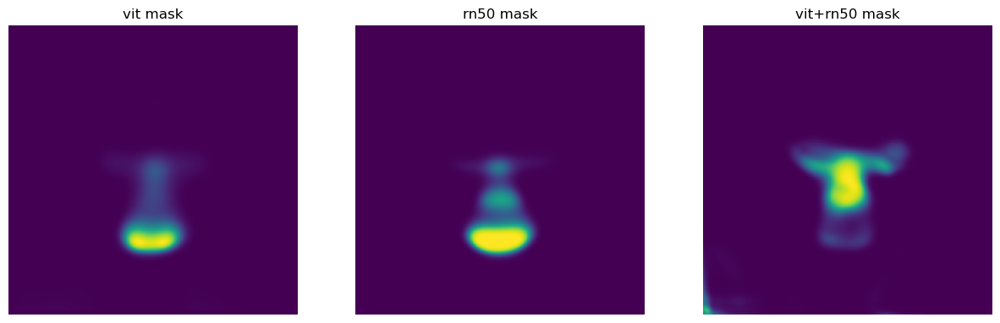

In [8]:
# show a specific image mask
dataset_name = 'ldm'
mask_name = '10491-2.png'
vit_mask_path = os.path.join(vit_results.path, dataset_name, mask_name)
rn50_mask_path = os.path.join(rn50_results.path, dataset_name, mask_name)
vit_rn50_mask_path = os.path.join(vit_rn50_results.path, dataset_name, mask_name)

# show the masks
vit_mask = plt.imread(vit_mask_path)
rn50_mask = plt.imread(rn50_mask_path)
vit_rn50_mask = plt.imread(vit_rn50_mask_path)
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.imshow(vit_mask)
plt.title('vit mask')
plt.axis('off')
plt.subplot(1, 3, 2)
plt.imshow(rn50_mask)
plt.title('rn50 mask')
plt.axis('off')
plt.subplot(1, 3, 3)
plt.imshow(vit_rn50_mask)
plt.title('vit+rn50 mask')
plt.axis('off')
plt.show()


C:\Users\vciup\AppData\Local\Temp\ipykernel_12696\512331727.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(15, 5))


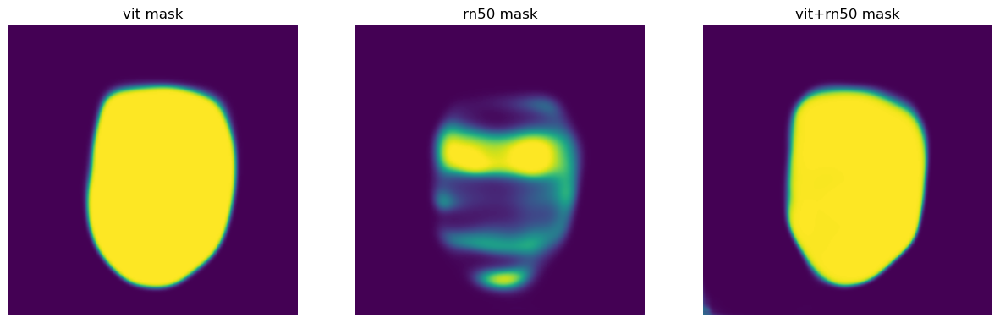

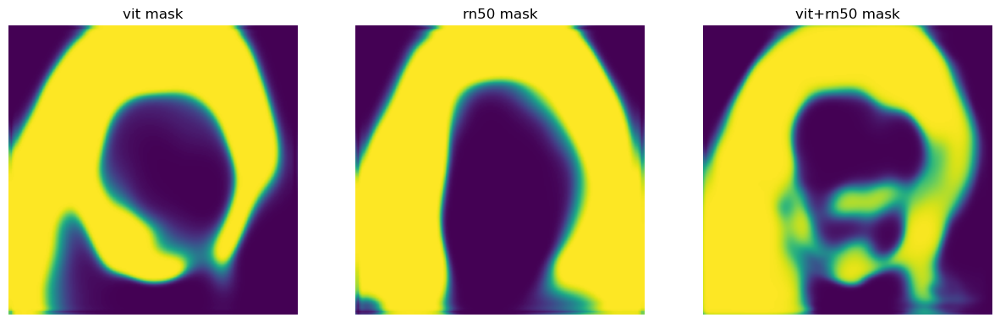

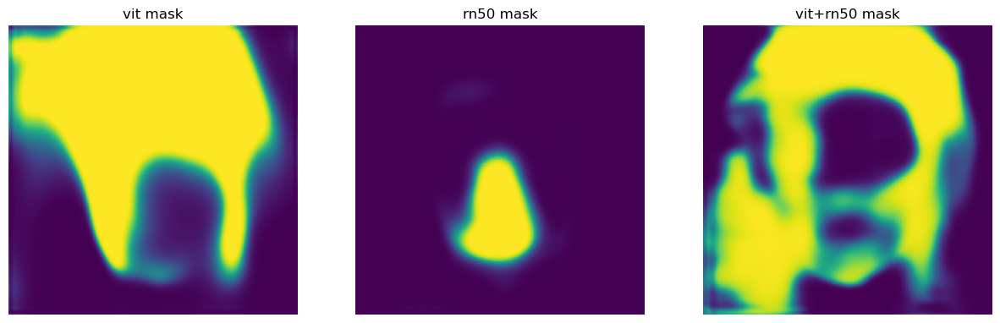

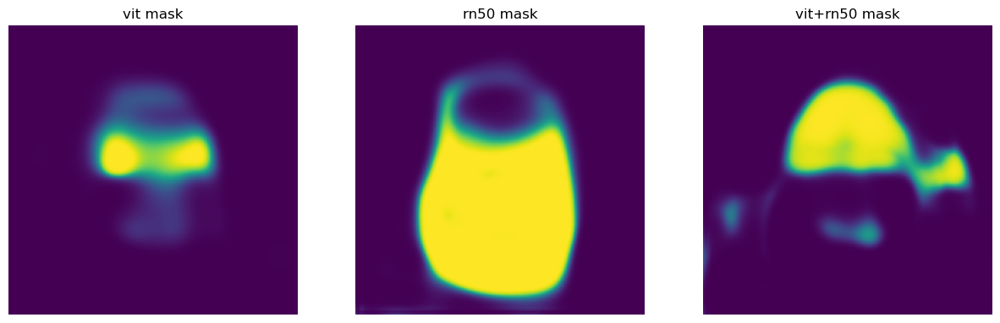

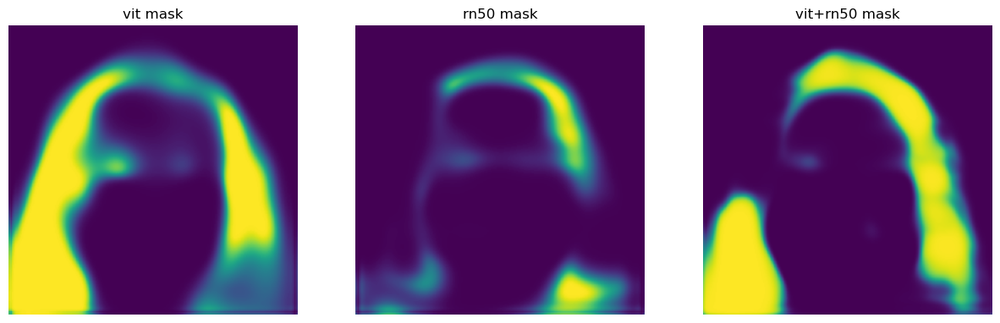

...

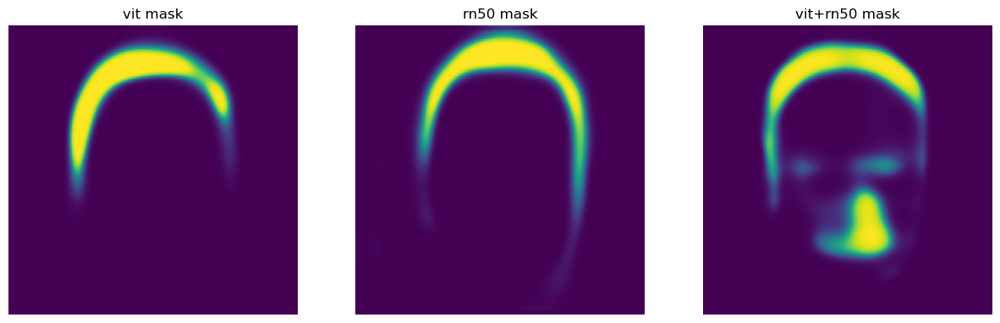

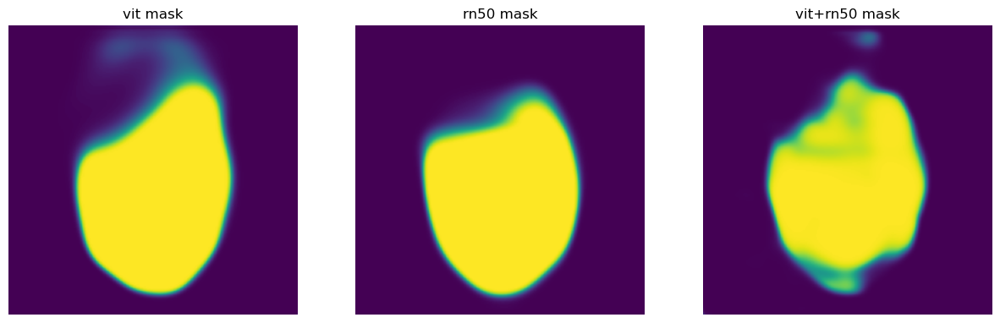

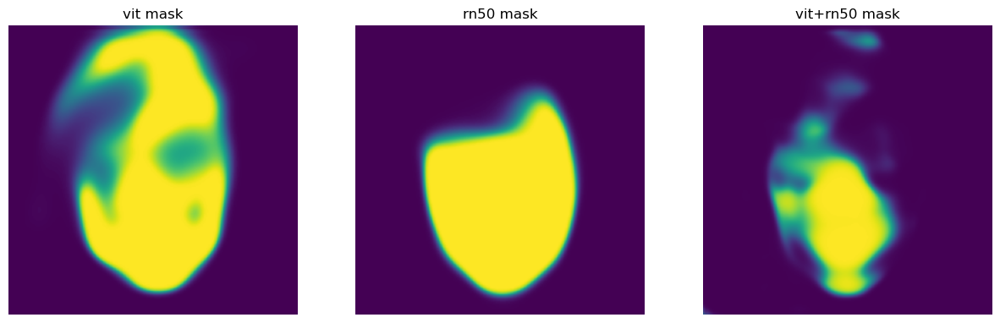

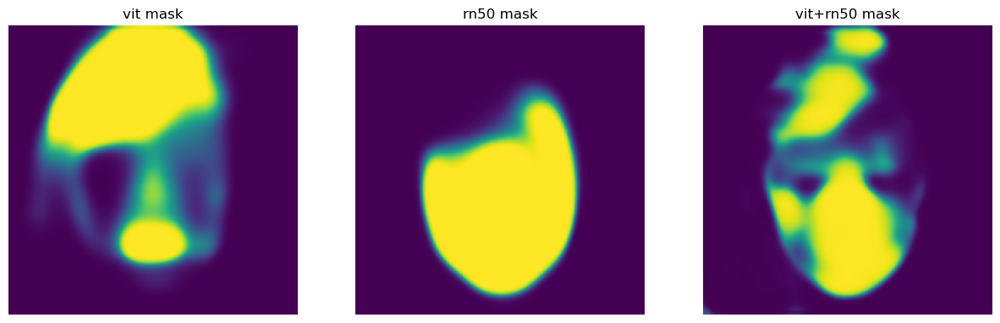

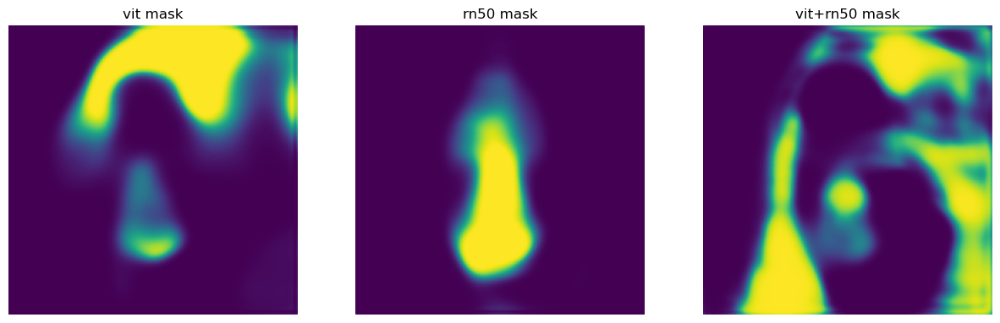

Error in callback <function flush_figures at 0x000001B5B94DA700> (for post_execute), with arguments args (),kwargs {}:


KeyboardInterrupt: 

In [9]:
# save such image comparisons in a new folder
output_path = os.path.join(vit_results.path, 'mask_comparisons')
if not os.path.exists(output_path):
    os.makedirs(output_path)
for dataset_name in test_datasets:
    dataset_path = os.path.join(output_path, dataset_name)
    if not os.path.exists(dataset_path):
        os.makedirs(dataset_path)
    for i, image_path in enumerate(test_image_paths):
        vit_iou = vit_results.scores[dataset_name]['iou'][i]
        rn50_iou = rn50_results.scores[dataset_name]['iou'][i]
        vit_rn50_iou = vit_rn50_results.scores[dataset_name]['iou'][i]

        # if vit_iou < 5 and rn50_iou < 5 and vit_rn50_iou < 5:
        #     continue

        image_name = image_path.split('/')[-1].split('.')[0] + '.png'
        vit_mask_path = os.path.join(vit_results.path, dataset_name, image_name)
        rn50_mask_path = os.path.join(rn50_results.path, dataset_name, image_name)
        vit_rn50_mask_path = os.path.join(vit_rn50_results.path, dataset_name, image_name)

        vit_mask = plt.imread(vit_mask_path)
        rn50_mask = plt.imread(rn50_mask_path)
        vit_rn50_mask = plt.imread(vit_rn50_mask_path)

        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(vit_mask)
        plt.title('vit mask')
        plt.axis('off')
        plt.subplot(1, 3, 2)
        plt.imshow(rn50_mask)
        plt.title('rn50 mask')
        plt.axis('off')
        plt.subplot(1, 3, 3)
        plt.imshow(vit_rn50_mask)
        plt.title('vit+rn50 mask')
        plt.axis('off')
        
        output_image_path = os.path.join(dataset_path, image_name.replace('.png', '_masks.png'))
        plt.savefig(output_image_path)

